In [227]:
# import the necessary libraries

import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
import plotly.figure_factory as ff
import cufflinks as cf
from plotly.offline import download_plotlyjs, init_notebook_mode, iplot
import chart_studio.plotly as py
import plotly
import nltk
import wordcloud
from nltk.corpus import stopwords
from wordcloud import WordCloud, STOPWORDS

In [184]:
plotly.offline.init_notebook_mode(connected=True)
cf.go_offline() # required to use plotly offline (no account required).

In [36]:
df = pd.read_csv("jigsaw-toxic-comment-train.csv")

In [4]:
df.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0


In [5]:
df.shape

(223549, 8)

In [6]:
[df.toxic.sum(), df.severe_toxic.sum(), df.obscene.sum(), df.threat.sum(), df.insult.sum(), df.identity_hate.sum()]

[21384, 1962, 12140, 689, 11304, 2117]

In [7]:
valid_df = pd.read_csv("validation.csv")
valid_df.head()

,id,comment_text,lang,toxic
0,0,Este usuario ni siquiera llega al rango de ...,es,0
1,1,Il testo di questa voce pare esser scopiazzato...,it,0
2,2,Vale. Sólo expongo mi pasado. Todo tiempo pasa...,es,1
3,3,Bu maddenin alt başlığı olarak uluslararası i...,tr,0
4,4,Belçika nın şehirlerinin yanında ilçe ve belde...,tr,0


In [8]:
test_df = pd.read_csv("test.csv")
test_df.head()

,id,content,lang
0,0,Doctor Who adlı viki başlığına 12. doctor olar...,tr
1,1,"Вполне возможно, но я пока не вижу необходимо...",ru
2,2,"Quindi tu sei uno di quelli conservativi , ...",it
3,3,Malesef gerçekleştirilmedi ancak şöyle bir şey...,tr
4,4,:Resim:Seldabagcan.jpg resminde kaynak sorunu ...,tr


In [ ]:
# Distribution of the type of comments in the dataset

In [78]:
df.describe()

,toxic,severe_toxic,obscene,threat,insult,identity_hate
count,223546.000000,223546.000000,223546.000000,223546.000000,223546.000000,223546.000000
mean,0.095658,0.008777,0.054306,0.003082,0.050567,0.009470
std,0.294123,0.093272,0.226622,0.055432,0.219112,0.096853
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [169]:
a = df[['toxic', 'severe_toxic', 'obscene', 'threat', 'insult', 'identity_hate']].apply(pd.Series.value_counts).iloc[1]
fig = px.bar(a, x= a.index, y = a.values, text = a.values, 
             labels={'index':"Comments", 'y':'count'})
fig.update_traces(texttemplate='%{text:.2s}', textposition='outside')
fig.update_layout(uniformtext_minsize=8, uniformtext_mode='hide')
fig.show()

In [9]:
# Distribution of languages in my training data

import langdetect
from langdetect import detect

In [90]:
[detect(df["comment_text"][105])]

'en'

In [95]:
language = []
for row in df.comment_text:
    try:
        language.append(detect(row))
    except:
        #language = "error"
        pass
        #print("This row throws and error:", row[0])

In [103]:
lang_ids = pd.read_csv("lang_ids.csv")

In [ ]:
pd.DataFrame(language).to_csv("lang_ids.csv")

In [176]:
fig = px.bar(lang_ids['0'].value_counts(), orientation = 'v', labels={'index':"Languages", 'value':'count'})
fig.update_layout(yaxis_type="log")
fig.show()

In [ ]:
# Let's get the count of characters from each comment

In [11]:
sent_lenghts = pd.Series([len(df["comment_text"][i]) for i in range(223549)])

In [12]:
fig = px.histogram(sent_lenghts, labels={'value':"Histogram of Number of Characters per comment", 'count':'count'})
fig.show()

In [230]:
df.toxic.value_counts(normalize = True).iplot(kind = 'bar')

In [37]:
# Let's first convert all the comment_text data into string
df["comment_text"] = df["comment_text"].astype("str")

In [63]:
list1 = df.comment_text.tolist()

In [191]:
stop_words = stopwords.words("english")

In [210]:
wc = wordcloud.WordCloud(stopwords = stop_words).generate(text)

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

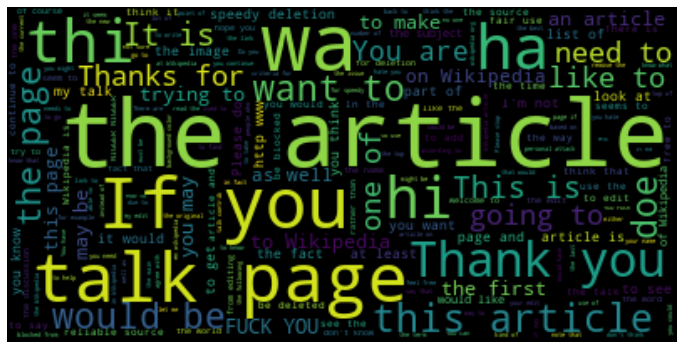

In [226]:
plt.figure(figsize = (12, 10))
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.margins(x=0, y=0)
plt.show()

In [212]:
wc.words_

{'the article': 1.0,
 'wa': 0.7486905000429345,
 'If you': 0.5930102756390073,
 'talk page': 0.571772046827146,
 'ha': 0.4549617883619086,
 'thi': 0.4206714944042133,
 'hi': 0.3786243810287088,
 'Thank you': 0.3601625783553253,
 'this article': 0.3554684145748061,
 'want to': 0.30034061310358645,
 'would be': 0.2971062197670092,
 'doe': 0.2956750722729484,
 'the page': 0.2624438274608581,
 'It is': 0.24257950024329508,
 'This is': 0.23516615622406045,
 'one of': 0.20954861608037326,
 'Thanks for': 0.20866130463405558,
 'need to': 0.206314222743796,
 'going to': 0.20256461630935685,
 'like to': 0.20159143601339555,
 'You are': 0.20004579671980993,
 'to Wikipedia': 0.19326215759796206,
 'an article': 0.18101153504880213,
 'to make': 0.17972350230414746,
 'FUCK YOU': 0.17972350230414746,
 'the first': 0.17714743681483813,
 'trying to': 0.17663222371697626,
 'may be': 0.17580215817042105,
 'you may': 0.17190943698657585,
 'on Wikipedia': 0.1685319289005925,
 'this page': 0.1683601912013052

In [206]:
text = " ".join(comment for comment in df.comment_text)
print ("There are {} words in the combination of all comments.".format(len(text)))

There are 87634042 words in the combination of all comments.


In [208]:
text[:800]

'Explanation\nWhy the edits made under my username Hardcore Metallica Fan were reverted? They weren\'t vandalisms, just closure on some GAs after I voted at New York Dolls FAC. And please don\'t remove the template from the talk page since I\'m retired now.89.205.38.27 D\'aww! He matches this background colour I\'m seemingly stuck with. Thanks.  (talk) 21:51, January 11, 2016 (UTC) Hey man, I\'m really not trying to edit war. It\'s just that this guy is constantly removing relevant information and talking to me through edits instead of my talk page. He seems to care more about the formatting than the actual info. "\nMore\nI can\'t make any real suggestions on improvement - I wondered if the section statistics should be later on, or a subsection of ""types of accidents""  -I think the references may ne'

In [ ]:
# Don't use all of the text for wordcloud, instead sample out the a limited amount of it and visualize the results. 
# Should lead to better visualizations

In [218]:
All_available_languages = set(language)

In [222]:
[All_available_languages]

[{'af',
  'ar',
  'bg',
  'bn',
  'ca',
  'cs',
  'cy',
  'da',
  'de',
  'el',
  'en',
  'es',
  'et',
  'fa',
  'fi',
  'fr',
  'gu',
  'he',
  'hi',
  'hr',
  'hu',
  'id',
  'it',
  'ja',
  'kn',
  'ko',
  'lt',
  'lv',
  'mk',
  'ml',
  'mr',
  'ne',
  'nl',
  'no',
  'pa',
  'pl',
  'pt',
  'ro',
  'ru',
  'sk',
  'sl',
  'so',
  'sq',
  'sv',
  'sw',
  'ta',
  'te',
  'th',
  'tl',
  'tr',
  'uk',
  'ur',
  'vi',
  'zh-cn',
  'zh-tw'}]

In [228]:
px.imshow(wc)

In [231]:
wc1 = wordcloud.WordCloud(collocations = False, stopwords = stop_words, ).generate(text)

In [232]:
px.imshow(wc1)

In [234]:
wc1.words_.keys()

dict_keys(['article', 'page', 'Wikipedia', 'talk', 'one', 'would', 'Please', 'like', 'edit', 'Thank', 'source', 'see', 'think', 'also', 'know', 'time', 'people', "I'm", 'use', 'make', 'user', 'may', 'say', 'get', 'image', 'need', 'name', 'new', 'even', 'link', 'good', 'well', 'want', 'way', 'fuck', 'section', 'information', 'could', 'comment', 'editor', 'WP', 'help', 'deletion', 'question', 'thing', 'first', 'look', 'fact', 'point', 'work', 'discussion', 'go', 'editing', 'seem', 'right', 'much', 'many', 'made', 'really', 'find', 'used', 'reference', 'take', "I've", 'list', 'deleted', 'since', 'read', 'add', 'change', 'someone', 'two', 'still', 'year', 'back', 'reason', 'state', 'content', 'word', 'issue', 'something', 'case', 'mean', 'http', 'going', 'wiki', 'said', 'Hi', 'place', 'note', 'stop', 'without', 'added', 'problem', 'history', 'block', 'blocked', 'day', 'person', 'might', 'another', 'removed', 'let', 'tag', 'sure', 'part', 'welcome', 'However', 'put', 'never', 'u', 'free', '

In [ ]:
stop_words.append(['one', 'would', 'also', 'may', 'could', 'Hi', ])

In [238]:
# Function that returns number of words in a string
def count_words(string):
	# Split the string into words
    words = string.split()
    
    # Return the number of words
    return len(words)

# Create a new feature word_count
df['word_count'] = df['comment_text'].apply(count_words)

# Print the average word count of the talks
print(df['word_count'].mean())

66.51804550293899


In [ ]:
word_count = [len(words) for word in df.comment_text.split()]

In [240]:
fig = px.histogram(df.word_count, labels={'value':"Histogram of Number of words per comment", 'count':'count'})
fig.show()

In [247]:
df.head()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate,word_count
0,0000997932d777bf,Explanation\nWhy the edits made under my usern...,0,0,0,0,0,0,43
1,000103f0d9cfb60f,D'aww! He matches this background colour I'm s...,0,0,0,0,0,0,17
2,000113f07ec002fd,"Hey man, I'm really not trying to edit war. It...",0,0,0,0,0,0,42
3,0001b41b1c6bb37e,"""\nMore\nI can't make any real suggestions on ...",0,0,0,0,0,0,113
4,0001d958c54c6e35,"You, sir, are my hero. Any chance you remember...",0,0,0,0,0,0,13


In [250]:
print(df.comment_text[df.word_count == 2321])

201191    C O M M I E - F U C K E R C O M M I E - F U C ...
Name: comment_text, dtype: object


In [253]:
df.comment_text.iloc[201190]

'C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E - F U C K E R C O M M I E